In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from copy import copy
from scipy import stats
import plotly.express as px
import plotly.figure_factory as ff
import plotly.graph_objects as go

In [3]:
# List of Stocks considered - 

# AAPL = Apple Stock 
# BA = Boeing 
# T = AT&T
# MGM = MGM Resorts International (Hotel Industry)
# AMZN = Amazon
# IBM = IBM
# TSLA = Tesla Motors
# GOOG = Google 
# sp500 = US Stock Market (S&P 500 is a stock market index that measures the stock performance of 500 large companies listed on U.S. stock exchange)
# Check the list of S&P 500 companies here: https://en.wikipedia.org/wiki/List_of_S%26P_500_companies

stocks_df = pd.read_csv('data/stock.csv')
stocks_df

,Date,AAPL,BA,T,MGM,AMZN,IBM,TSLA,GOOG,sp500
0,2012-01-12,60.198570,75.510002,30.120001,12.130000,175.929993,180.550003,28.250000,313.644379,1295.500000
1,2012-01-13,59.972858,74.599998,30.070000,12.350000,178.419998,179.160004,22.790001,311.328064,1289.089966
2,2012-01-17,60.671429,75.239998,30.250000,12.250000,181.660004,180.000000,26.600000,313.116364,1293.670044
3,2012-01-18,61.301430,75.059998,30.330000,12.730000,189.440002,181.070007,26.809999,315.273285,1308.040039
4,2012-01-19,61.107143,75.559998,30.420000,12.800000,194.449997,180.520004,26.760000,318.590851,1314.500000
...,...,...,...,...,...,...,...,...,...,...
2154,2020-08-05,440.250000,174.279999,29.850000,16.719999,3205.030029,125.449997,1485.020020,1473.609985,3327.770020
2155,2020-08-06,455.609985,172.199997,29.840000,18.459999,3225.000000,126.120003,1489.579956,1500.099976,3349.159912
2156,2020-08-07,444.450012,170.020004,30.020000,19.030001,3167.459961,124.959999,1452.709961,1494.489990,3351.280029
2157,2020-08-10,450.910004,179.410004,30.200001,21.650000,3148.159912,127.110001,1418.569946,1496.099976,3360.469971


In [23]:
# Sorting the stock data by date
stocks_df = stocks_df.sort_values(by = ['Date'])
stocks_df

,Date,AAPL,BA,T,MGM,AMZN,IBM,TSLA,GOOG,sp500
0,2012-01-12,60.198570,75.510002,30.120001,12.130000,175.929993,180.550003,28.250000,313.644379,1295.500000
1,2012-01-13,59.972858,74.599998,30.070000,12.350000,178.419998,179.160004,22.790001,311.328064,1289.089966
2,2012-01-17,60.671429,75.239998,30.250000,12.250000,181.660004,180.000000,26.600000,313.116364,1293.670044
3,2012-01-18,61.301430,75.059998,30.330000,12.730000,189.440002,181.070007,26.809999,315.273285,1308.040039
4,2012-01-19,61.107143,75.559998,30.420000,12.800000,194.449997,180.520004,26.760000,318.590851,1314.500000
...,...,...,...,...,...,...,...,...,...,...
2154,2020-08-05,440.250000,174.279999,29.850000,16.719999,3205.030029,125.449997,1485.020020,1473.609985,3327.770020
2155,2020-08-06,455.609985,172.199997,29.840000,18.459999,3225.000000,126.120003,1489.579956,1500.099976,3349.159912
2156,2020-08-07,444.450012,170.020004,30.020000,19.030001,3167.459961,124.959999,1452.709961,1494.489990,3351.280029
2157,2020-08-10,450.910004,179.410004,30.200001,21.650000,3148.159912,127.110001,1418.569946,1496.099976,3360.469971


In [5]:
# Printing the number of stocks
print('Total Number of stocks: {}'.format(len(stocks_df.columns[1:])))

Total Number of stocks: 9


In [6]:

# Printing the name of stocks
print('Stocks under consideration are:')

for i in stocks_df.columns[1:]:
  print(i)
     

Stocks under consideration are:
AAPL
BA
T
MGM
AMZN
IBM
TSLA
GOOG
sp500


## EDA & Basic Visualization

In [7]:
# Checking if data contains any null values
stocks_df.isnull().sum()

Date     0
AAPL     0
BA       0
T        0
MGM      0
AMZN     0
IBM      0
TSLA     0
GOOG     0
sp500    0
dtype: int64

In [8]:
# Getting dataframe info
stocks_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2159 entries, 0 to 2158
Data columns (total 10 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   Date    2159 non-null   object 
 1   AAPL    2159 non-null   float64
 2   BA      2159 non-null   float64
 3   T       2159 non-null   float64
 4   MGM     2159 non-null   float64
 5   AMZN    2159 non-null   float64
 6   IBM     2159 non-null   float64
 7   TSLA    2159 non-null   float64
 8   GOOG    2159 non-null   float64
 9   sp500   2159 non-null   float64
dtypes: float64(9), object(1)
memory usage: 168.8+ KB


In [9]:
# Defining a function to plot the entire dataframe
# The function takes in a dataframe df as an input argument and does not return anything back!
# The function performs data visualization

def show_plot(df, fig_title):
  df.plot(x = 'Date', figsize = (15,7), linewidth = 3, title = fig_title)
  plt.grid()
  plt.show()

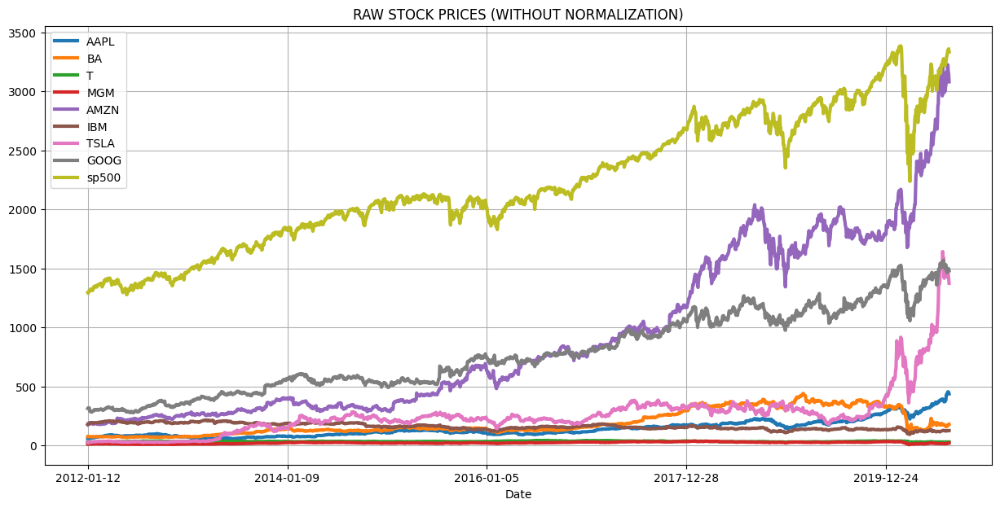

In [10]:

# Plot the data
show_plot(stocks_df, 'RAW STOCK PRICES (WITHOUT NORMALIZATION)')

### Interactive Data Visualization


In [11]:

# Function to perform an interactive data plotting using plotly express
# Plotly.express module which is imported as px includes functions that can plot interactive plots easily and effectively. 
# Every Plotly Express function uses graph objects internally and returns a plotly.graph_objects.Figure instance. 

def interactive_plot(df, title):
  fig = px.line(title = title)
  
  # Loop through each stock (while ignoring time columns with index 0)
  for i in df.columns[1:]:
    # Add a new Scatter trace
    fig.add_scatter(x = df['Date'], y = df[i], name = i) 

  fig.show()

### Calculating individual stock daily return

In [14]:
# Calculating daily return for a single security
df = stocks_df['sp500'] 
df_daily_return = df.copy()

# Looping through every element in the dataframe
for j in range(1, len(df)):

  # Calculating the percentage of change from the previous day
  df_daily_return[j] = ((df[j]- df[j-1])/df[j-1]) * 100

# Putting zero in the first line item
df_daily_return[0] = 0
df_daily_return

0       0.000000
1      -0.494792
2       0.355295
3       1.110793
4       0.493866
          ...   
2154    0.642974
2155    0.642770
2156    0.063303
2157    0.274222
2158   -0.796913
Name: sp500, Length: 2159, dtype: float64

In [15]:
# Defining a function to calculate stocks daily returns (for all stocks) 
def daily_return(df):
  df_daily_return = df.copy()

  # Loop through each stock (while ignoring time columns with index 0)
  for i in df.columns[1:]:
    
    # Loop through each row belonging to the stock
    for j in range(1, len(df)):

      # Calculate the percentage of change from the previous day
      df_daily_return[i][j] = ((df[i][j]- df[i][j-1])/df[i][j-1]) * 100
    
    # set the value of first row to zero since the previous value is not available
    df_daily_return[i][0] = 0
  
  return df_daily_return

In [16]:
# Getting the daily returns 
stocks_daily_return = daily_return(stocks_df)
stocks_daily_return

/var/folders/bp/rh2n6jz17sl3c_xbp6143kwc0000gn/T/ipykernel_932/2620491544.py:12: FutureWarning:

ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


/var/folders/bp/rh2n6jz17sl3c_xbp6143kwc0000gn/T/ipykernel_932/2620491544.py:12: FutureWarning:

ChainedAssignment

,Date,AAPL,BA,T,MGM,AMZN,IBM,TSLA,GOOG,sp500
0,2012-01-12,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,2012-01-13,-0.374946,-1.205144,-0.166006,1.813685,1.415339,-0.769869,-19.327430,-0.738516,-0.494792
2,2012-01-17,1.164812,0.857909,0.598603,-0.809717,1.815943,0.468852,16.717854,0.574410,0.355295
3,2012-01-18,1.038382,-0.239234,0.264463,3.918367,4.282725,0.594448,0.789470,0.688856,1.110793
4,2012-01-19,-0.316937,0.666134,0.296736,0.549882,2.644634,-0.303752,-0.186494,1.052283,0.493866
...,...,...,...,...,...,...,...,...,...,...
2154,2020-08-05,0.362467,5.579446,-0.533156,0.000000,2.109065,-0.309917,-0.133153,0.589774,0.642974
2155,2020-08-06,3.488923,-1.193483,-0.033501,10.406699,0.623082,0.534082,0.307062,1.797626,0.642770
2156,2020-08-07,-2.449458,-1.265966,0.603217,3.087768,-1.784187,-0.919762,-2.475194,-0.373974,0.063303
2157,2020-08-10,1.453480,5.522880,0.599604,13.767729,-0.609323,1.720552,-2.350092,0.107728,0.274222


### Calculating correlations between daily return

In [17]:
# Daily Return Correlation
cm = stocks_daily_return.drop(columns = ['Date']).corr()

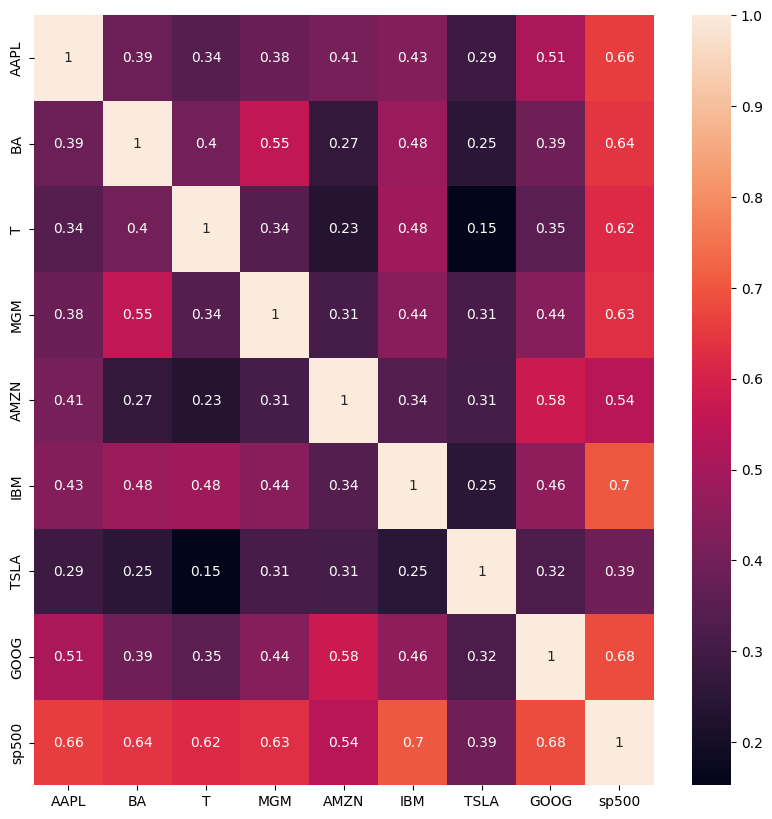

In [18]:
plt.figure(figsize=(10, 10))
ax = plt.subplot()
sns.heatmap(cm, annot = True, ax = ax);

### Histogram for Daily Returns

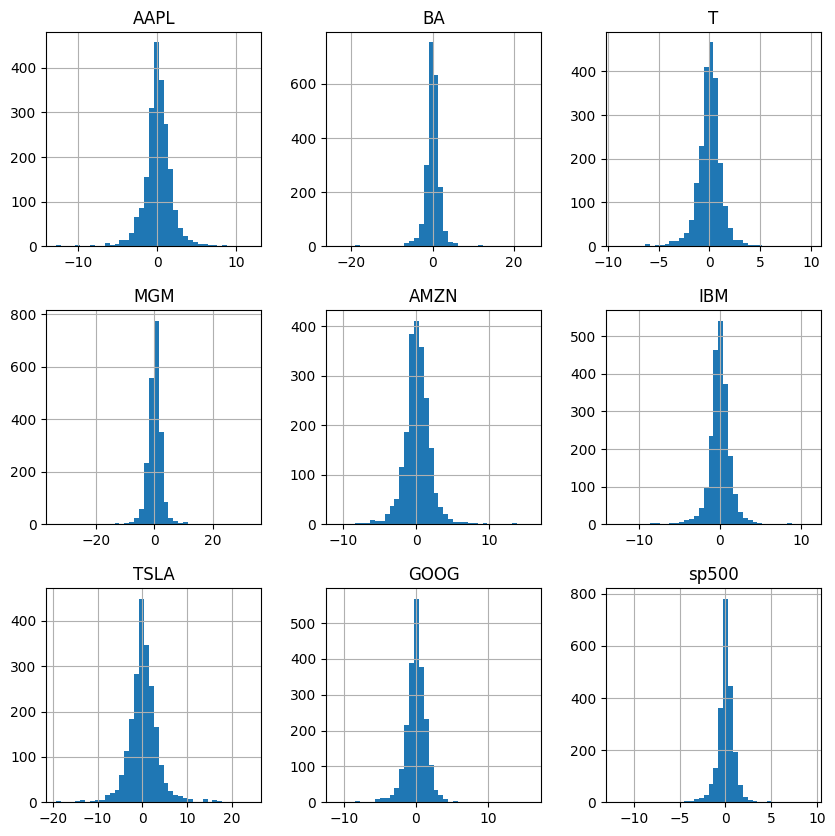

In [19]:
# Stock returns are normally distributed with zero mean 
stocks_daily_return.hist(figsize=(10, 10), bins = 40);

In [20]:
# Grouping all data returns together in a list
# Making a copy of the daily returns dataframe
df_hist = stocks_daily_return.copy()

# Dropping the date
df_hist = df_hist.drop(columns = ['Date'])

data = []

# Looping through every column
for i in df_hist.columns:
  data.append(stocks_daily_return[i].values)
data

[array([ 0.        , -0.37494578,  1.16481192, ..., -2.44945751,
         1.45347999, -2.9739868 ], shape=(2159,)),
 array([ 0.        , -1.20514366,  0.85790887, ..., -1.26596576,
         5.52287953,  0.40131597], shape=(2159,)),
 array([ 0.        , -0.16600597,  0.59860326, ...,  0.60321716,
         0.5996036 ,  0.        ], shape=(2159,)),
 array([ 0.        ,  1.81368508, -0.8097166 , ...,  3.08776831,
        13.76772918, -0.69284065], shape=(2159,)),
 array([ 0.        ,  1.41533854,  1.8159433 , ..., -1.78418726,
        -0.60932259, -2.14379167], shape=(2159,)),
 array([ 0.        , -0.76986928,  0.46885241, ..., -0.91976211,
         1.72055219, -0.28322004], shape=(2159,)),
 array([  0.        , -19.32743009,  16.71785359, ...,  -2.47519409,
         -2.35009162,  -3.1143992 ], shape=(2159,)),
 array([ 0.        , -0.73851634,  0.57441015, ..., -0.37397414,
         0.10772812, -1.05474435], shape=(2159,)),
 array([ 0.        , -0.49479228,  0.35529545, ...,  0.06330295,
 

In [ ]:
fig = ff.create_distplot(data, df_hist.columns)
fig.show()

### Additional Calculations & Visualizations

In [26]:
# Statistical data of the dataframe
stocks_df.describe()

,AAPL,BA,T,MGM,AMZN,IBM,TSLA,GOOG,sp500
count,2159.000000,2159.000000,2159.000000,2159.000000,2159.000000,2159.000000,2159.000000,2159.000000,2159.000000
mean,140.819823,189.942700,35.162899,23.105743,915.665665,161.853001,259.600815,783.712512,2218.749554
std,70.827601,103.678586,3.207490,6.963847,697.838905,25.561938,210.988003,334.448057,537.321727
min,55.790001,67.239998,26.770000,7.140000,175.929993,94.769997,22.790001,278.481171,1278.040039
25%,89.165714,124.015000,33.040001,18.545000,316.490005,142.769997,184.595001,527.214416,1847.984985
50%,116.599998,142.419998,34.930000,23.780001,676.010010,156.949997,231.960007,737.599976,2106.629883
75%,175.019997,297.044998,37.419998,28.430000,1593.645019,185.974998,307.350006,1079.744995,2705.810059
max,455.609985,440.619995,43.470001,38.029999,3225.000000,215.800003,1643.000000,1568.489990,3386.149902


In [27]:
# Function to normalize the prices based on the initial price
# The function simply divides every stock by it's price at the start date (i.e.: Date = 2012-01-12)	
def normalize(df):
  x = df.copy()

  # Loop through each stock (while ignoring time columns with index 0)
  for i in x.columns[1:]:
    x[i] = x[i]/x[i][0]
  return x

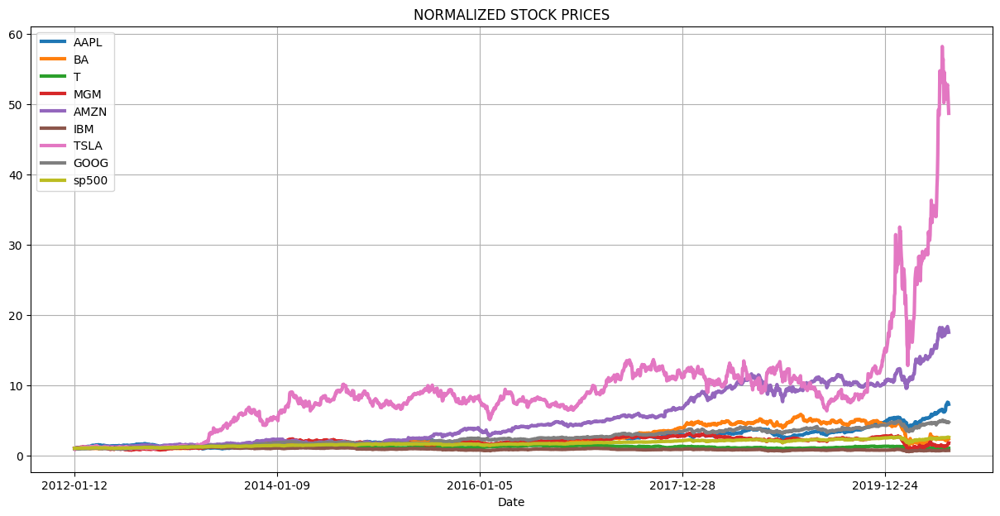

In [28]:
# Plotting normalized data
show_plot(normalize(stocks_df), 'NORMALIZED STOCK PRICES')

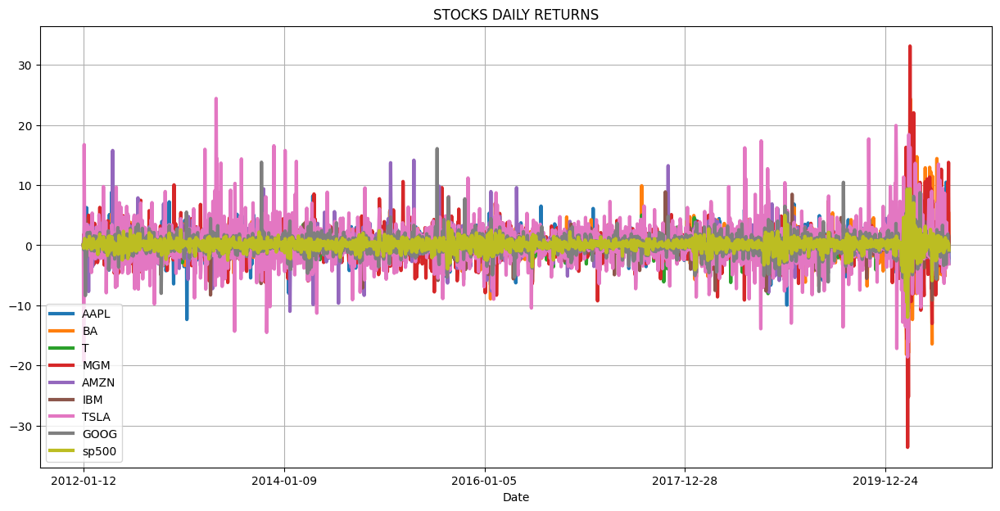

In [30]:
# Plotting the daily returns
show_plot(stocks_daily_return, 'STOCKS DAILY RETURNS')

## Asset Allocation & Statistical Data Analysis

Overview

Instead of analyzing individual stocks, we create a function to perform portfolio analysis, such as calculating returns, risks & other ratios
A Portfolio is a collection of financial investments such as stocks, fixed income securities (bonds), cash, mutual funds etc.
Types of Assets

1. Equities (Stocks)

A stock simply represents an ownership of a certain percentage of a company
It gives the owner the right to some shares in a given company
Stocks are generally liquid & are traded on stock exchanges

2. Fixed Income Securities (Bonds)

A Bond is a fixed income that is generally issued by governments or corporations
Bonds pay the investor a ficed stated interest rate
Bond coupons represent a semi-annual interest payment to the bond holder

3. Exchange Traded Funds (ETFs)

ETFs are a type of security that includes a group of securities & possible track an index
ETFs are more similar to mutual funds, however they are marketable securities & can be traded on exchanges just like stocks
Includes collection of stocks, bonds & commodities
Generally low management fees & offer a tool for risk diversification

In [31]:
stocks_df = stocks_df.sort_values(by = ['Date'])
stocks_df

,Date,AAPL,BA,T,MGM,AMZN,IBM,TSLA,GOOG,sp500
0,2012-01-12,60.198570,75.510002,30.120001,12.130000,175.929993,180.550003,28.250000,313.644379,1295.500000
1,2012-01-13,59.972858,74.599998,30.070000,12.350000,178.419998,179.160004,22.790001,311.328064,1289.089966
2,2012-01-17,60.671429,75.239998,30.250000,12.250000,181.660004,180.000000,26.600000,313.116364,1293.670044
3,2012-01-18,61.301430,75.059998,30.330000,12.730000,189.440002,181.070007,26.809999,315.273285,1308.040039
4,2012-01-19,61.107143,75.559998,30.420000,12.800000,194.449997,180.520004,26.760000,318.590851,1314.500000
...,...,...,...,...,...,...,...,...,...,...
2154,2020-08-05,440.250000,174.279999,29.850000,16.719999,3205.030029,125.449997,1485.020020,1473.609985,3327.770020
2155,2020-08-06,455.609985,172.199997,29.840000,18.459999,3225.000000,126.120003,1489.579956,1500.099976,3349.159912
2156,2020-08-07,444.450012,170.020004,30.020000,19.030001,3167.459961,124.959999,1452.709961,1494.489990,3351.280029
2157,2020-08-10,450.910004,179.410004,30.200001,21.650000,3148.159912,127.110001,1418.569946,1496.099976,3360.469971


Asset Allocation

Asset Allocation is an investment strategy that is used to allocate client's assets based on their risk tolerance, target returns & investment time span
The goal is to maximize returns & reduce risks

Random Asset Allocation & Daily Return Calculation

In [32]:
# Creating random portfolio weights
# Portfolio weights must sum to 1 

# Setting random seed
np.random.seed(101)

# Creating random weights for the stocks and normalizing them
weights = np.array(np.random.random(9))

# Ensuring that the sum of all weights is 1
weights = weights / np.sum(weights) 
print(weights)

[0.10921307 0.12069041 0.00602201 0.03627509 0.14492913 0.17636073
 0.06492024 0.1889901  0.15259921]


In [33]:
# Function to normalize the prices based on the initial price
# The function simply divides every stock by it's price at the start date (i.e.: Date = 2012-01-12)	
def normalize(df):
  x = df.copy()

  # Loop through each stock (while ignoring time columns with index 0)
  for i in x.columns[1:]:
    x[i] = x[i]/x[i][0]
  return x

In [34]:
# Normalize the stock avalues 
df_portfolio = normalize(stocks_df)
df_portfolio

,Date,AAPL,BA,T,MGM,AMZN,IBM,TSLA,GOOG,sp500
0,2012-01-12,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
1,2012-01-13,0.996251,0.987949,0.998340,1.018137,1.014153,0.992301,0.806726,0.992615,0.995052
2,2012-01-17,1.007855,0.996424,1.004316,1.009893,1.032570,0.996954,0.941593,0.998317,0.998587
3,2012-01-18,1.018320,0.994040,1.006972,1.049464,1.076792,1.002880,0.949027,1.005193,1.009680
4,2012-01-19,1.015093,1.000662,1.009960,1.055235,1.105269,0.999834,0.947257,1.015771,1.014666
...,...,...,...,...,...,...,...,...,...,...
2154,2020-08-05,7.313297,2.308039,0.991036,1.378401,18.217644,0.694821,52.567080,4.698347,2.568715
2155,2020-08-06,7.568452,2.280493,0.990704,1.521847,18.331155,0.698532,52.728494,4.782805,2.585226
2156,2020-08-07,7.383066,2.251622,0.996680,1.568838,18.004093,0.692107,51.423361,4.764919,2.586862
2157,2020-08-10,7.490377,2.375977,1.002656,1.784831,17.894390,0.704016,50.214865,4.770052,2.593956


In [35]:
df_portfolio.columns[1:]

Index(['AAPL', 'BA', 'T', 'MGM', 'AMZN', 'IBM', 'TSLA', 'GOOG', 'sp500'], dtype='object')

In [36]:
# Note that enumerate returns the value and a counter as well
for counter, stock in enumerate(df_portfolio.columns[1:]):
  df_portfolio[stock] = df_portfolio[stock] * weights[counter]
  df_portfolio[stock] = df_portfolio[stock] * 1000000
df_portfolio

,Date,AAPL,BA,T,MGM,AMZN,IBM,TSLA,GOOG,sp500
0,2012-01-12,109213.072967,120690.407490,6022.010143,36275.090893,1.449291e+05,176360.729910,6.492024e+04,188990.104235,152599.209597
1,2012-01-13,108803.583155,119235.914699,6012.013247,36933.006803,1.469804e+05,175002.982837,5.237283e+04,187594.381427,151844.160487
2,2012-01-17,110070.940263,120258.850187,6048.001354,36633.954117,1.496495e+05,175823.488543,6.112844e+04,188671.942595,152383.655881
3,2012-01-18,111213.896735,119971.149581,6063.996069,38069.407013,1.560585e+05,176868.668340,6.161103e+04,189971.620676,154076.322712
4,2012-01-19,110861.418590,120770.317932,6081.990122,38278.743893,1.601857e+05,176331.426972,6.149613e+04,191970.659033,154837.252810
...,...,...,...,...,...,...,...,...,...,...
2154,2020-08-05,798707.600095,278558.118654,5968.027783,50001.606220,2.640267e+06,122539.200612,3.412668e+06,887941.003611,391983.847760
2155,2020-08-06,826573.895966,275233.575119,5966.028443,55205.122968,2.656718e+06,123193.660569,3.423147e+06,903902.858806,394503.400529
2156,2020-08-07,806327.319584,271749.212299,6002.016551,56909.729263,2.609318e+06,122060.571958,3.338417e+06,900522.495854,394753.132817
2157,2020-08-10,818047.125846,286757.593922,6038.004858,64744.906663,2.593418e+06,124160.687803,3.259961e+06,901492.611827,395835.632149


In [42]:
numeric_cols = df_portfolio.select_dtypes(include='number')

# Create a new column with the sum of numeric columns
df_portfolio['portfolio daily worth in $'] = numeric_cols.sum(axis=1)

# Display the dataframe
df_portfolio

,Date,AAPL,BA,T,MGM,AMZN,IBM,TSLA,GOOG,sp500,portfolio daily worth in $
0,2012-01-12,109213.072967,120690.407490,6022.010143,36275.090893,1.449291e+05,176360.729910,6.492024e+04,188990.104235,152599.209597,1.000000e+06
1,2012-01-13,108803.583155,119235.914699,6012.013247,36933.006803,1.469804e+05,175002.982837,5.237283e+04,187594.381427,151844.160487,9.847792e+05
2,2012-01-17,110070.940263,120258.850187,6048.001354,36633.954117,1.496495e+05,175823.488543,6.112844e+04,188671.942595,152383.655881,1.000669e+06
3,2012-01-18,111213.896735,119971.149581,6063.996069,38069.407013,1.560585e+05,176868.668340,6.161103e+04,189971.620676,154076.322712,1.013905e+06
4,2012-01-19,110861.418590,120770.317932,6081.990122,38278.743893,1.601857e+05,176331.426972,6.149613e+04,191970.659033,154837.252810,1.020814e+06
...,...,...,...,...,...,...,...,...,...,...,...
2154,2020-08-05,798707.600095,278558.118654,5968.027783,50001.606220,2.640267e+06,122539.200612,3.412668e+06,887941.003611,391983.847760,8.588634e+06
2155,2020-08-06,826573.895966,275233.575119,5966.028443,55205.122968,2.656718e+06,123193.660569,3.423147e+06,903902.858806,394503.400529,8.664444e+06
2156,2020-08-07,806327.319584,271749.212299,6002.016551,56909.729263,2.609318e+06,122060.571958,3.338417e+06,900522.495854,394753.132817,8.506059e+06
2157,2020-08-10,818047.125846,286757.593922,6038.004858,64744.906663,2.593418e+06,124160.687803,3.259961e+06,901492.611827,395835.632149,8.450456e+06


In [43]:
# Calculating the portfolio daily return 
# Defining a new column in the dataframe and setting it to zeros
df_portfolio['portfolio daily % return'] = 0.0000

for i in range(1, len(stocks_df)):
  # Calculating the percentage of change from the previous day
  df_portfolio['portfolio daily % return'][i] = ( (df_portfolio['portfolio daily worth in $'][i] - df_portfolio['portfolio daily worth in $'][i-1]) / df_portfolio['portfolio daily worth in $'][i-1]) * 100 

df_portfolio

/var/folders/bp/rh2n6jz17sl3c_xbp6143kwc0000gn/T/ipykernel_932/1959795581.py:7: FutureWarning:

ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


/var/folders/bp/rh2n6jz17sl3c_xbp6143kwc0000gn/T/ipykernel_932/1959795581.py:7: FutureWarning:

ChainedAssignmentEr

,Date,AAPL,BA,T,MGM,AMZN,IBM,TSLA,GOOG,sp500,portfolio daily worth in $,portfolio daily % return
0,2012-01-12,109213.072967,120690.407490,6022.010143,36275.090893,1.449291e+05,176360.729910,6.492024e+04,188990.104235,152599.209597,1.000000e+06,0.000000
1,2012-01-13,108803.583155,119235.914699,6012.013247,36933.006803,1.469804e+05,175002.982837,5.237283e+04,187594.381427,151844.160487,9.847792e+05,-1.522076
2,2012-01-17,110070.940263,120258.850187,6048.001354,36633.954117,1.496495e+05,175823.488543,6.112844e+04,188671.942595,152383.655881,1.000669e+06,1.613507
3,2012-01-18,111213.896735,119971.149581,6063.996069,38069.407013,1.560585e+05,176868.668340,6.161103e+04,189971.620676,154076.322712,1.013905e+06,1.322705
4,2012-01-19,110861.418590,120770.317932,6081.990122,38278.743893,1.601857e+05,176331.426972,6.149613e+04,191970.659033,154837.252810,1.020814e+06,0.681427
...,...,...,...,...,...,...,...,...,...,...,...,...
2154,2020-08-05,798707.600095,278558.118654,5968.027783,50001.606220,2.640267e+06,122539.200612,3.412668e+06,887941.003611,391983.847760,8.588634e+06,0.879605
2155,2020-08-06,826573.895966,275233.575119,5966.028443,55205.122968,2.656718e+06,123193.660569,3.423147e+06,903902.858806,394503.400529,8.664444e+06,0.882669
2156,2020-08-07,806327.319584,271749.212299,6002.016551,56909.729263,2.609318e+06,122060.571958,3.338417e+06,900522.495854,394753.132817,8.506059e+06,-1.827981
2157,2020-08-10,818047.125846,286757.593922,6038.004858,64744.906663,2.593418e+06,124160.687803,3.259961e+06,901492.611827,395835.632149,8.450456e+06,-0.653686


Portfolio Allocation - Daily Return/Worth Calculation

In [44]:
# Lets assume we have $1,000,000 to be invested and we will allocate this fund based on the weights of the stocks
# We will create a function that takes in the stock prices along with the weights and retun:
# (1) Daily value of each individual securuty in $ over the specified time period
# (2) Overall daily worth of the entire portfolio 
# (3) Daily return 

def portfolio_allocation(df, weights):
  
  df_portfolio = df.copy()
  
  # Normalize the stock avalues 
  df_portfolio = normalize(df_portfolio)
  
  for counter, stock in enumerate(df_portfolio.columns[1:]):
    df_portfolio[stock] = df_portfolio[stock] * weights[counter]
    df_portfolio[stock] = df_portfolio[stock] * 1000000

  df_portfolio['portfolio daily worth in $'] = df_portfolio[df_portfolio != 'Date'].sum(axis = 1)
  
  df_portfolio['portfolio daily % return'] = 0.0000

  for i in range(1, len(stocks_df)):
    
    # Calculate the percentage of change from the previous day
    df_portfolio['portfolio daily % return'][i] = ( (df_portfolio['portfolio daily worth in $'][i] - df_portfolio['portfolio daily worth in $'][i-1]) / df_portfolio['portfolio daily worth in $'][i-1]) * 100 
  
  # set the value of first row to zero, as previous value is not available
  df_portfolio['portfolio daily % return'][0] = 0
  return df_portfolio
     

Portfolio Statistical Metrics

1. Stock Daily Return

It is a calculation of how much investors have gained / lost per day

2. Cumulative Return

It is a measure of the aggregate amount that the stock gained or lost over a period of time

3. Standard Deviation (Risk / Volatility)

It is a measure of dispersion away from the mean
The more spread the data is, the higher the standard deviation
Volatile stocks have higher standard deviation & therefore, it represents the risk assoicated with a security

4. Sharpe Ratio

Sharpe Ratio is used by investors to calculate the return of an investment compared to its risk
It is simply a calculation of the average return of an investment compared to its risk
As the ratio increases, the risk-adjusted return increases & the security becomes more desired by the investors

In [46]:
# Cummulative return of the portfolio (We now look for the last net worth of the portfolio compared to it's start value)
cummulative_return = ((df_portfolio['portfolio daily worth in $'][-1:] - df_portfolio['portfolio daily worth in $'][0])/ df_portfolio['portfolio daily worth in $'][0]) * 100
print('Cummulative return of the portfolio is {} %'.format(cummulative_return.values[0]))

Cummulative return of the portfolio is 725.668957781923 %


In [47]:

# Calculating the portfolio standard deviation
print('Standard deviation of the portfolio is {}'.format(df_portfolio['portfolio daily % return'].std()))

Standard deviation of the portfolio is 1.4491482034679335


In [48]:
# Calculating the average daily return 
print('Average daily return of the portfolio is {} %'.format(df_portfolio['portfolio daily % return'].mean() ))
     

Average daily return of the portfolio is 0.10836656759421484 %


In [49]:
# Portfolio sharpe ratio
sharpe_ratio = df_portfolio['portfolio daily % return'].mean() / df_portfolio['portfolio daily % return'].std() * np.sqrt(252)
print('Sharpe ratio of the portfolio is {}'.format(sharpe_ratio))

Sharpe ratio of the portfolio is 1.187087646115863



Capital Asset Pricing Model

It is a model that describes the relationship between the expected return & risk of securities
It indicates that the expected return on a security is equal to the risk-free return plus a risk premium

Risk Free Asset

CAPM assumes that there exists a risk free asset with zero standard deviation
Investors who are extremely risk averse would prefer to buy the risk free asset to protect their money & earn a low return
If investors are interested in gaining more return, they have to bear more risk compared to the risk free asset

Market Portfolio

Market Portfolio includes all securities in the market

Beta

Beta represents the slope of the regression line (market return vs. stock return)
Beta is a measure of the volatility or systematic risk of a security or portfolio compared to the entire market
It is used in CAPM & describes the relationship between systematic return & expected return for assets
Different Values for Beta

Beta = 1.0

This indicates that the price activity is strongly correlated with the market

Beta < 1 (Defensive)

This indicates that the security's price is less volatile than the market

Beta > 1 (Aggressive)

This indicates that the security's price is more volatile than the market

In [50]:
stocks_df = stocks_df.sort_values(by = ['Date'])
stocks_df

,Date,AAPL,BA,T,MGM,AMZN,IBM,TSLA,GOOG,sp500
0,2012-01-12,60.198570,75.510002,30.120001,12.130000,175.929993,180.550003,28.250000,313.644379,1295.500000
1,2012-01-13,59.972858,74.599998,30.070000,12.350000,178.419998,179.160004,22.790001,311.328064,1289.089966
2,2012-01-17,60.671429,75.239998,30.250000,12.250000,181.660004,180.000000,26.600000,313.116364,1293.670044
3,2012-01-18,61.301430,75.059998,30.330000,12.730000,189.440002,181.070007,26.809999,315.273285,1308.040039
4,2012-01-19,61.107143,75.559998,30.420000,12.800000,194.449997,180.520004,26.760000,318.590851,1314.500000
...,...,...,...,...,...,...,...,...,...,...
2154,2020-08-05,440.250000,174.279999,29.850000,16.719999,3205.030029,125.449997,1485.020020,1473.609985,3327.770020
2155,2020-08-06,455.609985,172.199997,29.840000,18.459999,3225.000000,126.120003,1489.579956,1500.099976,3349.159912
2156,2020-08-07,444.450012,170.020004,30.020000,19.030001,3167.459961,124.959999,1452.709961,1494.489990,3351.280029
2157,2020-08-10,450.910004,179.410004,30.200001,21.650000,3148.159912,127.110001,1418.569946,1496.099976,3360.469971


In [51]:
# Function to normalize the prices based on the initial price
def normalize(df):
  x = df.copy()
  for i in x.columns[1:]:
    x[i] = x[i]/x[i][0]
  return x

Calculating Daily Returns

In [52]:
# Function to calculate the daily returns 
def daily_return(df):

  df_daily_return = df.copy()
  
  # Loop through each stock
  for i in df.columns[1:]:
    
    # Loop through each row belonging to the stock
    for j in range(1, len(df)):
      
      # Calculate the percentage of change from the previous day
      df_daily_return[i][j] = ((df[i][j]- df[i][j-1])/df[i][j-1]) * 100
    
    # Set the value of first row to zero, as previous value is not available
    df_daily_return[i][0] = 0
  return df_daily_return

In [53]:
# Get the daily returns 
stocks_daily_return = daily_return(stocks_df)
stocks_daily_return

/var/folders/bp/rh2n6jz17sl3c_xbp6143kwc0000gn/T/ipykernel_932/590112222.py:13: FutureWarning:

ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


/var/folders/bp/rh2n6jz17sl3c_xbp6143kwc0000gn/T/ipykernel_932/590112222.py:13: FutureWarning:

ChainedAssignmentEr

,Date,AAPL,BA,T,MGM,AMZN,IBM,TSLA,GOOG,sp500
0,2012-01-12,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,2012-01-13,-0.374946,-1.205144,-0.166006,1.813685,1.415339,-0.769869,-19.327430,-0.738516,-0.494792
2,2012-01-17,1.164812,0.857909,0.598603,-0.809717,1.815943,0.468852,16.717854,0.574410,0.355295
3,2012-01-18,1.038382,-0.239234,0.264463,3.918367,4.282725,0.594448,0.789470,0.688856,1.110793
4,2012-01-19,-0.316937,0.666134,0.296736,0.549882,2.644634,-0.303752,-0.186494,1.052283,0.493866
...,...,...,...,...,...,...,...,...,...,...
2154,2020-08-05,0.362467,5.579446,-0.533156,0.000000,2.109065,-0.309917,-0.133153,0.589774,0.642974
2155,2020-08-06,3.488923,-1.193483,-0.033501,10.406699,0.623082,0.534082,0.307062,1.797626,0.642770
2156,2020-08-07,-2.449458,-1.265966,0.603217,3.087768,-1.784187,-0.919762,-2.475194,-0.373974,0.063303
2157,2020-08-10,1.453480,5.522880,0.599604,13.767729,-0.609323,1.720552,-2.350092,0.107728,0.274222


Calculating BETA for a Single Stock

In [54]:

# Select any stock, let's say Apple 
stocks_daily_return['AAPL']

0       0.000000
1      -0.374946
2       1.164812
3       1.038382
4      -0.316937
          ...   
2154    0.362467
2155    3.488923
2156   -2.449458
2157    1.453480
2158   -2.973987
Name: AAPL, Length: 2159, dtype: float64

In [55]:
# Select the S&P500 (Market)
stocks_daily_return['sp500']

0       0.000000
1      -0.494792
2       0.355295
3       1.110793
4       0.493866
          ...   
2154    0.642974
2155    0.642770
2156    0.063303
2157    0.274222
2158   -0.796913
Name: sp500, Length: 2159, dtype: float64

<Axes: xlabel='sp500', ylabel='AAPL'>

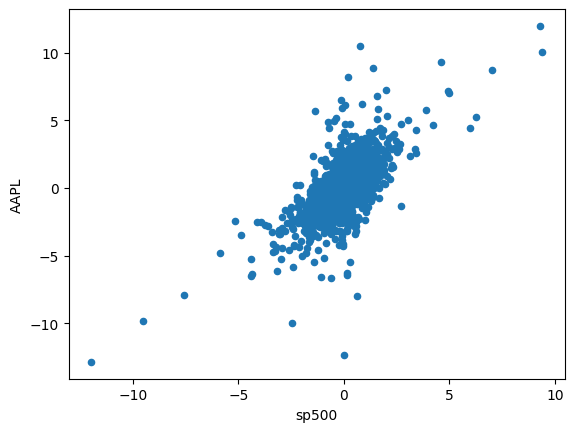

In [56]:
# Plotting a scatter plot between the selected stock and the S&P500 (Market)
stocks_daily_return.plot(kind = 'scatter', x = 'sp500', y = 'AAPL')

In [57]:
# Fit a polynomial between the selected stock and the S&P500 (Poly with order = 1 is a straight line)

# Beta represents the slope of the line regression line (market return vs. stock return). 
# Beta is a measure of the volatility or systematic risk of a security or portfolio compared to the entire market (S&P500) 
# Beta is used in the CAPM and describes the relationship between systematic risk and expected return for assets 

# Beta = 1.0, this indicates that its price activity is strongly correlated with the market. 
# Beta < 1, indicates that the security is theoretically less volatile than the market (Ex: Utility stocks). If the stock is included, this will make the portfolio less risky compared to the same portfolio without the stock.
# Beta > 1, indicates that the security's price is more volatile than the market. For instance, Tesla stock beta is 1.26 indicating that it's 26% more volatile than the market. 
# Tech stocks generally have higher betas than S&P500 but they also have excess returns
# MGM is 65% more volatile than the S&P500!


beta, alpha = np.polyfit(stocks_daily_return['sp500'], stocks_daily_return['AAPL'], 1)
print('Beta for {} stock is = {} and alpha is = {}'.format('AAPL', beta, alpha))  

Beta for AAPL stock is = 1.1128924148678097 and alpha is = 0.052812084694402905


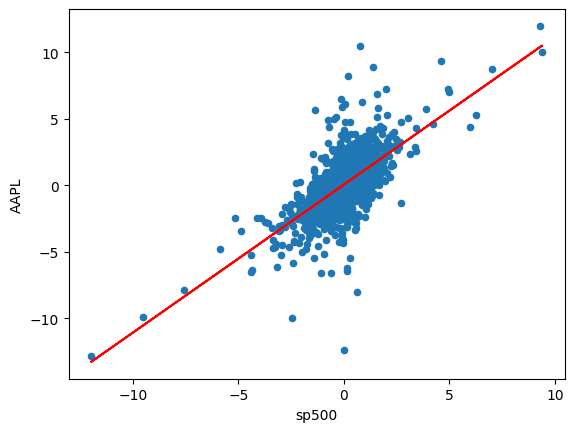

In [58]:
# Plotting the scatter plot and the straight line on one plot
stocks_daily_return.plot(kind = 'scatter', x = 'sp500', y = 'AAPL')

# Straight line equation with alpha and beta parameters 
# Straight line equation is y = beta * rm + alpha
plt.plot(stocks_daily_return['sp500'], beta * stocks_daily_return['sp500'] + alpha, '-', color = 'r')

Applying the CAPM formula to an individual Srock

In [59]:
beta

np.float64(1.1128924148678097)

In [60]:
# Calculating the average daily rate of return for S&P500
stocks_daily_return['sp500'].mean()

np.float64(0.04931600660038911)

In [61]:
# Calculating the annualized rate of return for S&P500 
# Note that out of 365 days/year, stock exchanges are closed for 104 days during weekend days (Saturday and Sunday) 
rm = stocks_daily_return['sp500'].mean() * 252
rm

np.float64(12.427633663298055)

In [62]:
# Assuming risk free rate is zero
rf = 0 

# Calculating return for any security (APPL) using CAPM  
ER_AAPL = rf + ( beta * (rm-rf) ) 
ER_AAPL

np.float64(13.830619238640256)

Calculating BETA for All Stocks

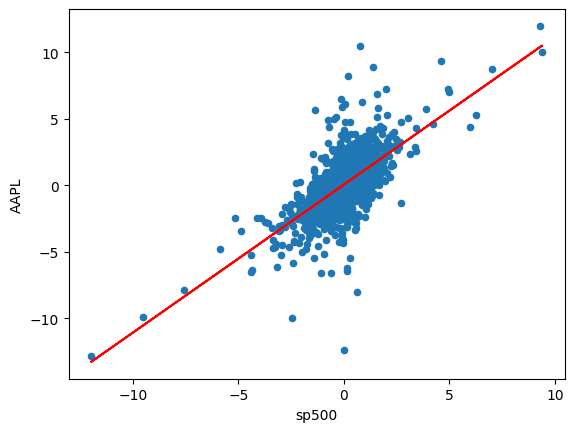

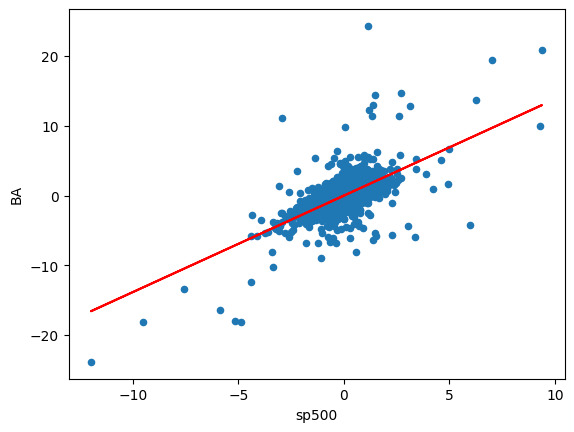

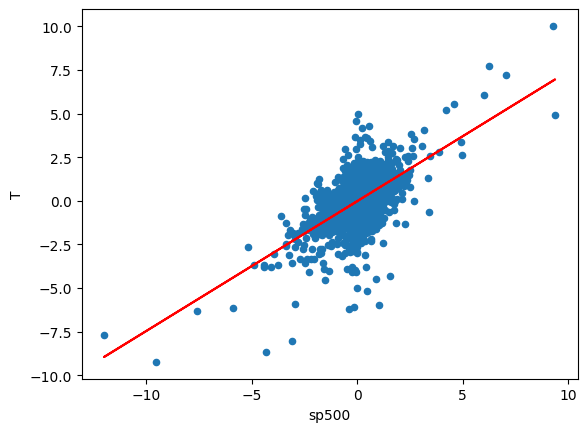

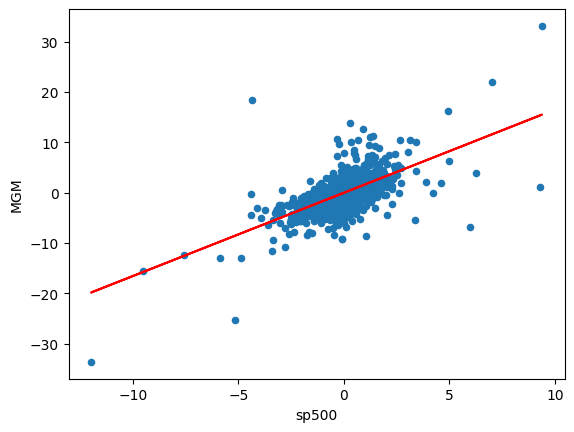

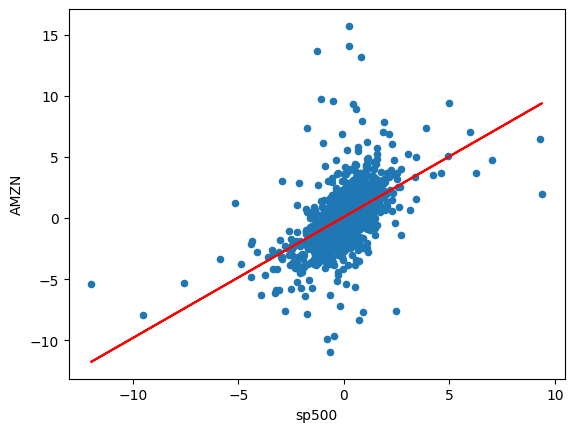

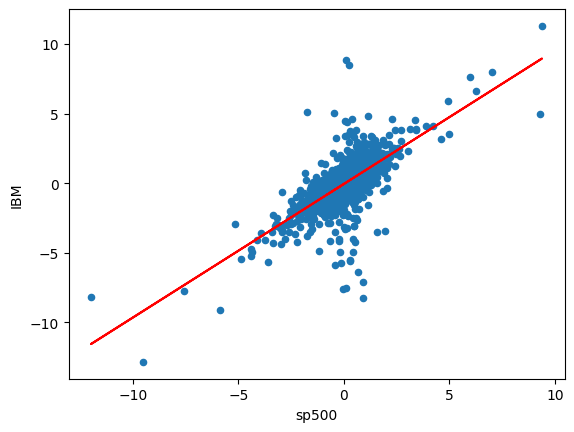

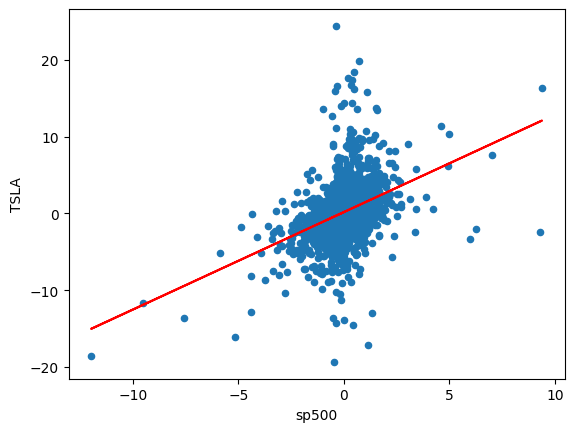

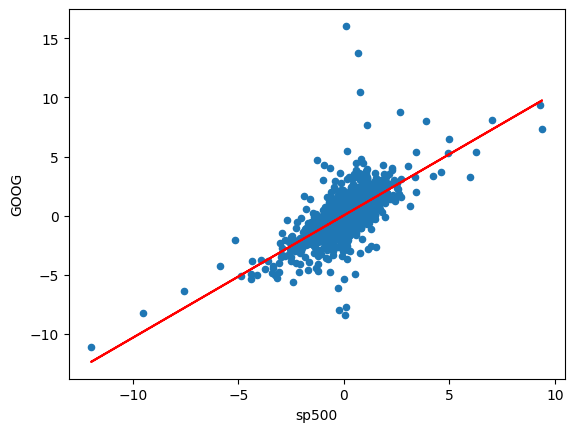

In [63]:
# Creating a placeholder for all betas and alphas (empty dictionaries)
beta = {}
alpha = {}

# Loop on every stock daily return
for i in stocks_daily_return.columns:

  # Ignoring the date and S&P500 Columns 
  if i != 'Date' and i != 'sp500':
    # Plot a scatter plot between each individual stock and the S&P500 (Market)
    stocks_daily_return.plot(kind = 'scatter', x = 'sp500', y = i)
    
    # Fit a polynomial between each stock and the S&P500 (Poly with order = 1 is a straight line)
    b, a = np.polyfit(stocks_daily_return['sp500'], stocks_daily_return[i], 1)
    plt.plot(stocks_daily_return['sp500'], b * stocks_daily_return['sp500'] + a, '-', color = 'r')
    beta[i] = b
    alpha[i] = a
    plt.show()

In [64]:
# Viewing Beta for every stock 
beta
     

{'AAPL': np.float64(1.1128924148678097),
 'BA': np.float64(1.3828672010892775),
 'T': np.float64(0.7446293454747844),
 'MGM': np.float64(1.653567706518011),
 'AMZN': np.float64(0.9917345712576846),
 'IBM': np.float64(0.9604149148095246),
 'TSLA': np.float64(1.2686150101095903),
 'GOOG': np.float64(1.0348817687428562)}

In [65]:
# Viewing alpha for each of the stocks
# Alpha describes the strategy's ability to beat the market (S&P500)
# Alpha indicates the “excess return” or “abnormal rate of return” 
# A positive 0.175 alpha for Tesla means that the portfolio’s return exceeded the benchmark S&P500 index by 17%.

alpha

{'AAPL': np.float64(0.052812084694402905),
 'BA': np.float64(-0.0022906983297531543),
 'T': np.float64(-0.028563430198461616),
 'MGM': np.float64(-0.016885305520478674),
 'AMZN': np.float64(0.1022139641776522),
 'IBM': np.float64(-0.05345494150445116),
 'TSLA': np.float64(0.17583492165165812),
 'GOOG': np.float64(0.03335558721467016)}

Applying CAPM formula to calculate Return for the Portfolio

In [67]:
# Obtain a list of all stock names
keys = list(beta.keys())
keys

['AAPL', 'BA', 'T', 'MGM', 'AMZN', 'IBM', 'TSLA', 'GOOG']

In [68]:
# Define the expected return dictionary
ER = {}

rf = 0 # Assuming risk free rate is zero in this case
rm = stocks_daily_return['sp500'].mean() * 252 # This is the expected return of the market 
rm

np.float64(12.427633663298055)

In [69]:
for i in keys:
  # Calculate return for every security using CAPM  
  ER[i] = rf + ( beta[i] * (rm-rf) ) 

In [70]:
for i in keys:
  print('Expected Return Based on CAPM for {} is {}%'.format(i, ER[i]))

Expected Return Based on CAPM for AAPL is 13.830619238640256%
Expected Return Based on CAPM for BA is 17.185766980127866%
Expected Return Based on CAPM for T is 9.253980720502028%
Expected Return Based on CAPM for MGM is 20.549933694065793%
Expected Return Based on CAPM for AMZN is 12.324913942818466%
Expected Return Based on CAPM for IBM is 11.935684726020382%
Expected Return Based on CAPM for TSLA is 15.765882605403148%
Expected Return Based on CAPM for GOOG is 12.861131506762153%


In [71]:
# Assuming equal weights in the portfolio
portfolio_weights = 1/8 * np.ones(8) 
portfolio_weights

array([0.125, 0.125, 0.125, 0.125, 0.125, 0.125, 0.125, 0.125])

In [72]:
# Calculating the portfolio return 
ER_portfolio = sum(list(ER.values()) * portfolio_weights)
ER_portfolio

np.float64(14.21348917679251)

In [73]:
print('Expected Return Based on CAPM for the portfolio is {}%\n'.format(ER_portfolio))

Expected Return Based on CAPM for the portfolio is 14.21348917679251%

